<a href="https://colab.research.google.com/github/Holuwasege/Zipf-s-law/blob/main/Assignment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
 !pip install nltk pandas scikit-learn matplotlib numpy seaborn
 !pip install transformers
 !pip install datasets

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
import re
from collections import Counter
import torch
from transformers import pipeline, AutoTokenizer
from datasets import load_dataset

In [ ]:
frame = load_dataset("castorini/wura", "ibo", level="passage", verification_mode="no_checks")
frame_word = frame["validation"]["text"]
frame_word

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


README.md:   0%|          | 0.00/11.1k [00:00<?, ?B/s]

wura.py:   0%|          | 0.00/3.80k [00:00<?, ?B/s]

The repository for castorini/wura contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/castorini/wura.
You can avoid this prompt in future by passing the argument `trust_remote_code=True`.

Do you wish to run the custom code? [y/N] y


ibo.txt:   0%|          | 0.00/178M [00:00<?, ?B/s]

ibo.txt:   0%|          | 0.00/20.4M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/51386 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/5709 [00:00<?, ? examples/s]

['Kirie ka ndị Arochukwu si eme nke ka.',
 '“Ka mkpụrụ obi Peter Pan zuru ike n’udo,” Onye isi ala kpere ekpere.',
 'N’ịkọwa na ọrịa Coronavirus metụtara akụkụ dị mma nke ọnụnọ ya na mba ahụ, onye nnọchi anya Thinh toro President Buhari maka etu Naịjirịa siri gbasoo ihe ịma aka ahụike zuru ụwa ọnụ nke ọma, na otu esi ewulite akụ na ụba.',
 'Ha merechara rịọ mgbaghara maka ihe a mere ma wepụ ya na soshal midia ha',
 'Ndị Alakụba Naịjirịa na-ekele Ndị Kraịst na mmemme Ista Ndi otu Muslim Ummah nke Naijiria, n’okpuru ndu nke Onye isi oche-General nke Council Supreme Council for Islamic Affairs, NSCIA na Sultan nke Sokoto, Alhaji Muhammad Sa’ad Abubakar ekelela onye isi otu Christian Association of Nigeria, CAN His Eminence, Archbishop Daniel. Okoh na ndi kristi niile na Naijiria n’ememe oma nke Ista. Na nkwupụta nke osote odeakwụkwọ ukwu nke NSCIA, Prọfesọ Salisu Shehu binyere aka, otu kansụl ahụ kpere ekpere ka ememe Ista bụrụ isi mmalite maka mmeghari mmụọ, ịkpọte okpukperechi na ịmụgha

In [ ]:
all_word = []
for item in frame_word:
  words = item.split()
  all_word.extend(words)

print(all_word[0:50])

['Kirie', 'ka', 'ndị', 'Arochukwu', 'si', 'eme', 'nke', 'ka.', '“Ka', 'mkpụrụ', 'obi', 'Peter', 'Pan', 'zuru', 'ike', 'n’udo,”', 'Onye', 'isi', 'ala', 'kpere', 'ekpere.', 'N’ịkọwa', 'na', 'ọrịa', 'Coronavirus', 'metụtara', 'akụkụ', 'dị', 'mma', 'nke', 'ọnụnọ', 'ya', 'na', 'mba', 'ahụ,', 'onye', 'nnọchi', 'anya', 'Thinh', 'toro', 'President', 'Buhari', 'maka', 'etu', 'Naịjirịa', 'siri', 'gbasoo', 'ihe', 'ịma', 'aka']


In [ ]:
count_words = Counter(all_word)
count_words

Counter({'Kirie': 16,
         'ka': 35567,
         'ndị': 46908,
         'Arochukwu': 6,
         'si': 7142,
         'eme': 2435,
         'nke': 63453,
         'ka.': 38,
         '“Ka': 63,
         'mkpụrụ': 1454,
         'obi': 3675,
         'Peter': 147,
         'Pan': 25,
         'zuru': 2036,
         'ike': 19155,
         'n’udo,”': 1,
         'Onye': 2852,
         'isi': 6040,
         'ala': 4120,
         'kpere': 88,
         'ekpere.': 31,
         'N’ịkọwa': 3,
         'na': 164877,
         'ọrịa': 1775,
         'Coronavirus': 63,
         'metụtara': 672,
         'akụkụ': 1424,
         'dị': 32852,
         'mma': 6047,
         'ọnụnọ': 109,
         'ya': 29994,
         'mba': 3448,
         'ahụ,': 4038,
         'onye': 17296,
         'nnọchi': 206,
         'anya': 5906,
         'Thinh': 1,
         'toro': 144,
         'President': 81,
         'Buhari': 259,
         'maka': 18883,
         'etu': 480,
         'Naịjirịa': 704,
         'siri

In [ ]:
sort_word = sorted(count_words.items(), key=lambda x: x[1], reverse=True)
sort_word

[('na', 164877),
 ('nke', 63453),
 ('ọ', 47446),
 ('ndị', 46908),
 ('a', 42855),
 ('bụ', 38419),
 ('ihe', 37915),
 ('ka', 35567),
 ('dị', 32852),
 ('ma', 30112),
 ('ya', 29994),
 ('ha', 20818),
 ('ike', 19155),
 ('maka', 18883),
 ('nwere', 18868),
 ('ọrụ', 18534),
 ('ahụ', 17716),
 ('onye', 17296),
 ('ị', 14212),
 ('anyị', 13534),
 ('Ọ', 13128),
 ('gị', 12868),
 ('-', 12792),
 ('iji', 10110),
 ('e', 9974),
 ('mgbe', 9961),
 ('otu', 9944),
 ('site', 9923),
 ('o', 9378),
 ('ebe', 9343),
 ('(1)', 9308),
 ('nọ', 9044),
 ('m', 8984),
 ('ụlọ', 8355),
 ('iche', 7932),
 ('bụrụ', 7626),
 ('si', 7142),
 ('aka', 6891),
 ('ọzọ', 6780),
 ('mere', 6428),
 ('mmadụ', 6267),
 ('mma', 6047),
 ('isi', 6040),
 ('na-eme', 5923),
 ('anya', 5906),
 ('A', 5811),
 ('afọ', 5738),
 ('niile', 5692),
 ('bụla', 5502),
 ('Na', 5469),
 ('ego', 5446),
 ("n'ime", 5431),
 ('akwụkwọ', 5423),
 ('ọtụtụ', 5306),
 ('Ihe', 5258),
 ('Ndị', 5240),
 ('usoro', 5065),
 ('ụzọ', 4989),
 ('ozi', 4967),
 ('oge', 4963),
 ('otú', 4815),

In [ ]:
words = [text for text, freq in sort_word]
words

['na',
 'nke',
 'ọ',
 'ndị',
 'a',
 'bụ',
 'ihe',
 'ka',
 'dị',
 'ma',
 'ya',
 'ha',
 'ike',
 'maka',
 'nwere',
 'ọrụ',
 'ahụ',
 'onye',
 'ị',
 'anyị',
 'Ọ',
 'gị',
 '-',
 'iji',
 'e',
 'mgbe',
 'otu',
 'site',
 'o',
 'ebe',
 '(1)',
 'nọ',
 'm',
 'ụlọ',
 'iche',
 'bụrụ',
 'si',
 'aka',
 'ọzọ',
 'mere',
 'mmadụ',
 'mma',
 'isi',
 'na-eme',
 'anya',
 'A',
 'afọ',
 'niile',
 'bụla',
 'Na',
 'ego',
 "n'ime",
 'akwụkwọ',
 'ọtụtụ',
 'Ihe',
 'Ndị',
 'usoro',
 'ụzọ',
 'ozi',
 'oge',
 'otú',
 'ngwa',
 '/',
 'ya.',
 'of',
 'ya,',
 'ọkụ',
 'abụọ',
 'ala',
 'ahịa',
 'ahụ,',
 'wee',
 'ụmụ',
 'the',
 'banyere',
 'obi',
 'onwe',
 'O',
 'ime',
 'Mgbe',
 '.',
 'a,',
 'Jehova',
 'elu',
 'iri',
 'mba',
 'and',
 'mkpa',
 'ụgbọ',
 'ndụ',
 'Nke',
 'ọnụ',
 'kwuru',
 'ji',
 'mmiri',
 'ruo',
 'ke',
 'mee',
 'ahụ.',
 'aha',
 'i',
 'The',
 'dịka',
 'ụdị',
 'I',
 "n'ihi",
 ',',
 'ne',
 'nwa',
 'okwu',
 'E',
 'Onye',
 'iwu',
 'ụfọdụ',
 'na-enye',
 'mbụ',
 'obodo',
 'Chineke',
 'ugbu',
 '$',
 'egwu',
 'chọrọ',
 '>'

In [ ]:
frequency = [freq for words, freq in sort_word]
frequency

[164877,
 63453,
 47446,
 46908,
 42855,
 38419,
 37915,
 35567,
 32852,
 30112,
 29994,
 20818,
 19155,
 18883,
 18868,
 18534,
 17716,
 17296,
 14212,
 13534,
 13128,
 12868,
 12792,
 10110,
 9974,
 9961,
 9944,
 9923,
 9378,
 9343,
 9308,
 9044,
 8984,
 8355,
 7932,
 7626,
 7142,
 6891,
 6780,
 6428,
 6267,
 6047,
 6040,
 5923,
 5906,
 5811,
 5738,
 5692,
 5502,
 5469,
 5446,
 5431,
 5423,
 5306,
 5258,
 5240,
 5065,
 4989,
 4967,
 4963,
 4815,
 4738,
 4720,
 4592,
 4490,
 4331,
 4162,
 4137,
 4120,
 4115,
 4038,
 3989,
 3931,
 3818,
 3788,
 3675,
 3670,
 3666,
 3647,
 3642,
 3578,
 3549,
 3522,
 3461,
 3454,
 3448,
 3415,
 3394,
 3394,
 3348,
 3347,
 3325,
 3309,
 3292,
 3287,
 3190,
 3184,
 3180,
 3146,
 3125,
 3111,
 3102,
 3077,
 3061,
 3052,
 3016,
 2984,
 2932,
 2870,
 2856,
 2856,
 2852,
 2840,
 2815,
 2812,
 2808,
 2804,
 2802,
 2664,
 2586,
 2574,
 2569,
 2526,
 2524,
 2469,
 2457,
 2435,
 2413,
 2404,
 2368,
 2360,
 2330,
 2306,
 2301,
 2299,
 2296,
 2285,
 2280,
 2277,
 2

In [ ]:
  plt.figure(figsize=(10, 6))
  plt.loglog(words, frequency, marker='o')
  plt.xlabel('words')
  plt.ylabel('frequency')
  plt.title('Words vs Frequency')
  plt.grid(True)
  plt.show()

# **LOADING DATASET FOR YORÙBÁ**


In [ ]:
def remove_punctuations(text):
    text = re.sub(r'[^\w\s]', '', text)
    return text

In [ ]:
def tokenize_text(clean_text):
  tokenizer = AutoTokenizer.from_pretrained("castorini/afriteva_v2_large")
  tokenized_text = [tokenizer.tokenize(text) for text in clean_text]
  return tokenized_text


In [ ]:
def Count(tokenized_text):
  tokens = [token for sublist in tokenized_text for token in sublist]
  Count_text = Counter(tokens)
  return Count_text

In [ ]:
def sort(all_token):
  sort_text = sorted(all_token.items(), key=lambda x: x[1], reverse=True)
  return sort_text

In [ ]:
def Ranking(sorted_token):
  Ranked_text = range(1, len(sorted_token) +1)
  return Ranked_text

In [ ]:
def Frequent(sorted_token):
  Frequent_text = [freq for token, freq in sorted_token]
  return Frequent_text

In [ ]:
def zipflaw(Rank, Frequencies):
  plt.figure(figsize=(10, 6))
  plt.loglog(Rank, Frequencies, marker='o')
  plt.xlabel('Rank')
  plt.ylabel('Frequency')
  plt.title('Rank vs Frequency')
  plt.grid(True)
  plt.show()


In [ ]:
def process_plot_zipflaw(lang):
  data = load_dataset("castorini/wura", lang, level="passage", verification_mode="no_checks")
  df = pd.DataFrame(data['validation'])
  clean_text = df['text'].apply(remove_punctuations)
  tokenized_text = tokenize_text(clean_text)
  all_token = Count(tokenized_text)
  sorted_token = sort(all_token)
  Rank = Ranking(sorted_token)
  Frequencies = Frequent(sorted_token)
  Plot_zipflaw = zipflaw(Rank, Frequencies)
  return Plot_zipflaw

# Plotting Zipf Law for YORUBA


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


README.md:   0%|          | 0.00/11.1k [00:00<?, ?B/s]

wura.py:   0%|          | 0.00/3.80k [00:00<?, ?B/s]

The repository for castorini/wura contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/castorini/wura.
You can avoid this prompt in future by passing the argument `trust_remote_code=True`.

Do you wish to run the custom code? [y/N] y


yor.txt:   0%|          | 0.00/171M [00:00<?, ?B/s]

yor.txt:   0%|          | 0.00/18.7M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/73473 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/8163 [00:00<?, ? examples/s]

tokenizer_config.json:   0%|          | 0.00/2.31k [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/2.91M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/2.20k [00:00<?, ?B/s]

You are using the default legacy behaviour of the <class 'transformers.models.t5.tokenization_t5.T5Tokenizer'>. This is expected, and simply means that the `legacy` (previous) behavior will be used so nothing changes for you. If you want to use the new behaviour, set `legacy=False`. This should only be set if you understand what it means, and thoroughly read the reason why this was added as explained in https://github.com/huggingface/transformers/pull/24565
/usr/local/lib/python3.10/dist-packages/transformers/convert_slow_tokenizer.py:561: UserWarning: The sentencepiece tokenizer that you are converting to a fast tokenizer uses the byte fallback option which is not implemented in the fast tokenizers. In practice this means that the fast version of the tokenizer can produce unknown tokens whereas the sentencepiece version would have converted these unknown tokens into a sequence of byte tokens matching the original piece of text.
  warnings.warn(
Token indices sequence length is longer 

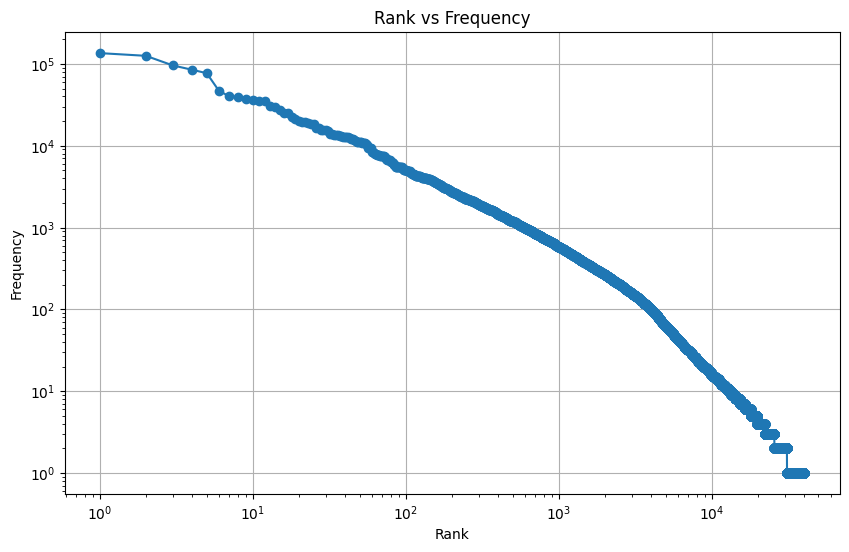

In [ ]:
Zipf_law = process_plot_zipflaw("yor")
Zipf_law


# The plot shown here is revealing the token for Yoruba langauge that has the highest number of frequence and the lowest frequency. In this plot the hightest rank token is ranked high while the lowest frequency is ranked low. Looking at the plot, the highest frequency has about 100th thousand tokens and it is ranked first in the ranking position. For example: In the list of tokens "àwọn" with the frequency 456,789, "ọmọ" with the frequency 12,987 and "rògbòdìyàn" with frequency 10. "àwọn" will be ranked high while "rògbòdìyàn" will be ranked low. Technically this is what the plot is revealing and the same explanation go's for all those languages. So therefore, 10^5 on the frequency side is telling us that the token in that position is the ranked first while 10^0 on the frequency side is telling us that, the token found in this position is ranked low. The lowest rank is about 10th thousand position.





# The same explanation is applicable to all other languages.
   

# Plotting Zipf Law for IGBO

ibo.txt:   0%|          | 0.00/178M [00:00<?, ?B/s]

ibo.txt:   0%|          | 0.00/20.4M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/51386 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/5709 [00:00<?, ? examples/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (713 > 512). Running this sequence through the model will result in indexing errors


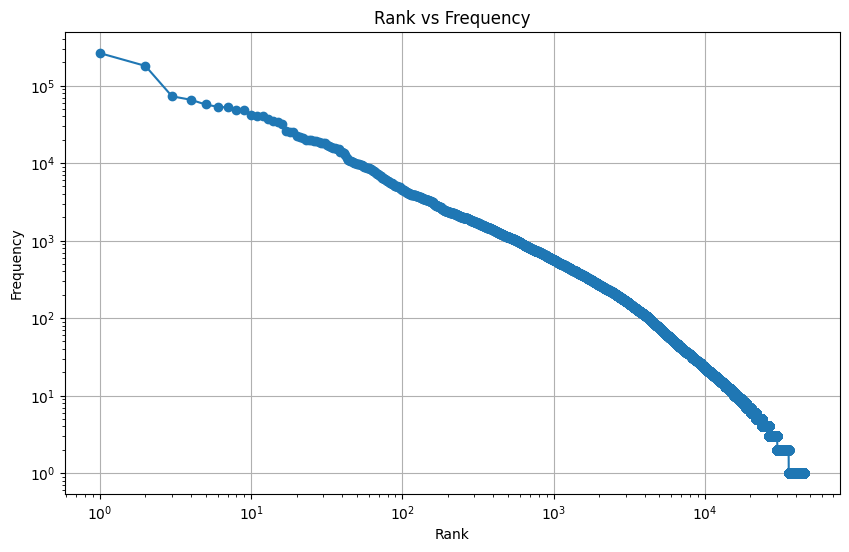

In [ ]:
Zipf_law = process_plot_zipflaw("ibo")
Zipf_law

# Plotting Zipf Law for ZULU




zul.txt:   0%|          | 0.00/263M [00:00<?, ?B/s]

zul.txt:   0%|          | 0.00/28.7M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/65447 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/7271 [00:00<?, ? examples/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (1279 > 512). Running this sequence through the model will result in indexing errors


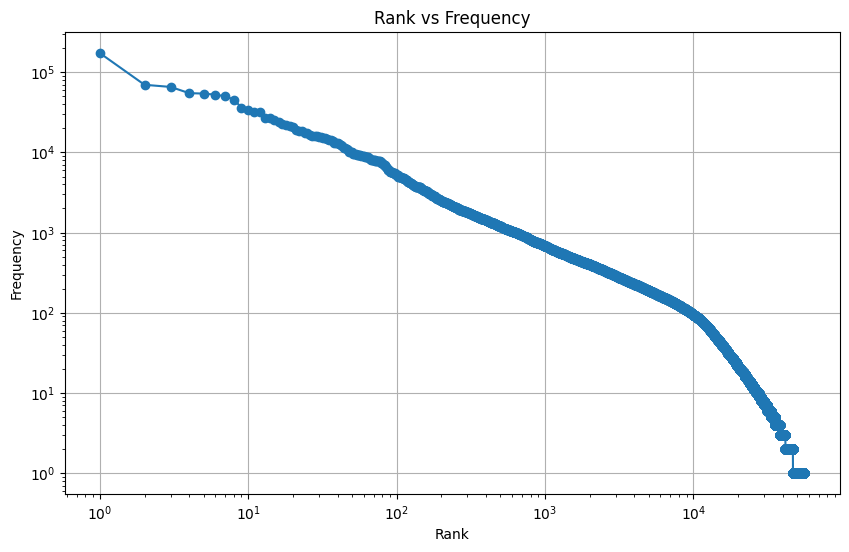

In [ ]:
Zipf_law = process_plot_zipflaw("zul")
Zipf_law

 # Plotting Zipf Law for HAUSA



hau.txt:   0%|          | 0.00/668M [00:00<?, ?B/s]

hau.txt:   0%|          | 0.00/74.3M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/359881 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/39986 [00:00<?, ? examples/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (736 > 512). Running this sequence through the model will result in indexing errors


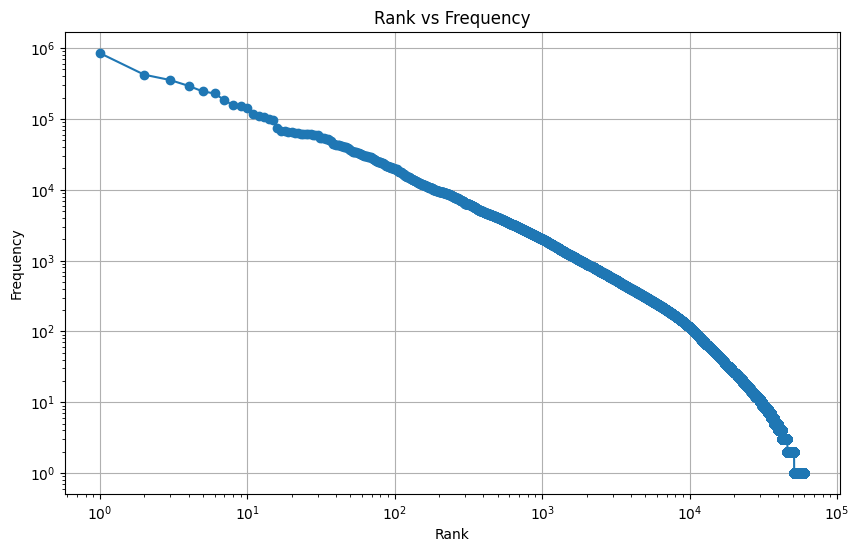

In [ ]:
Zipf_law = process_plot_zipflaw("hau")
Zipf_law

# Plotting Zipf Law for XHOSA

xho.txt:   0%|          | 0.00/111M [00:00<?, ?B/s]

xho.txt:   0%|          | 0.00/12.7M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/23892 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/2654 [00:00<?, ? examples/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/convert_slow_tokenizer.py:551: UserWarning: The sentencepiece tokenizer that you are converting to a fast tokenizer uses the byte fallback option which is not implemented in the fast tokenizers. In practice this means that the fast version of the tokenizer can produce unknown tokens whereas the sentencepiece version would have converted these unknown tokens into a sequence of byte tokens matching the original piece of text.
  warnings.warn(
Token indices sequence length is longer than the specified maximum sequence length for this model (700 > 512). R

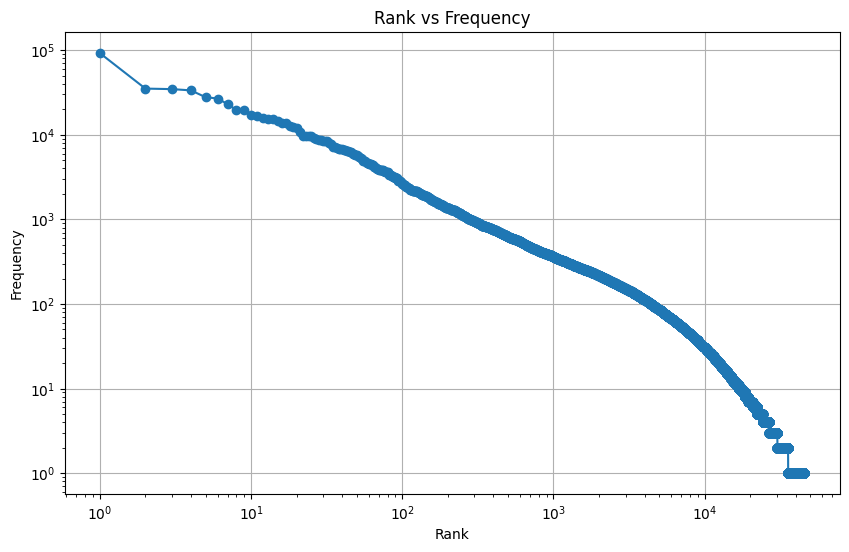

In [ ]:
Zipf_law = process_plot_zipflaw("xho")
Zipf_law

# Plotting Zipf Law for OROMO

orm.txt:   0%|          | 0.00/42.9M [00:00<?, ?B/s]

orm.txt:   0%|          | 0.00/4.53M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/20169 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/2241 [00:00<?, ? examples/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/convert_slow_tokenizer.py:551: UserWarning: The sentencepiece tokenizer that you are converting to a fast tokenizer uses the byte fallback option which is not implemented in the fast tokenizers. In practice this means that the fast version of the tokenizer can produce unknown tokens whereas the sentencepiece version would have converted these unknown tokens into a sequence of byte tokens matching the original piece of text.
  warnings.warn(
Token indices sequence length is longer than the specified maximum sequence length for this model (624 > 512). R

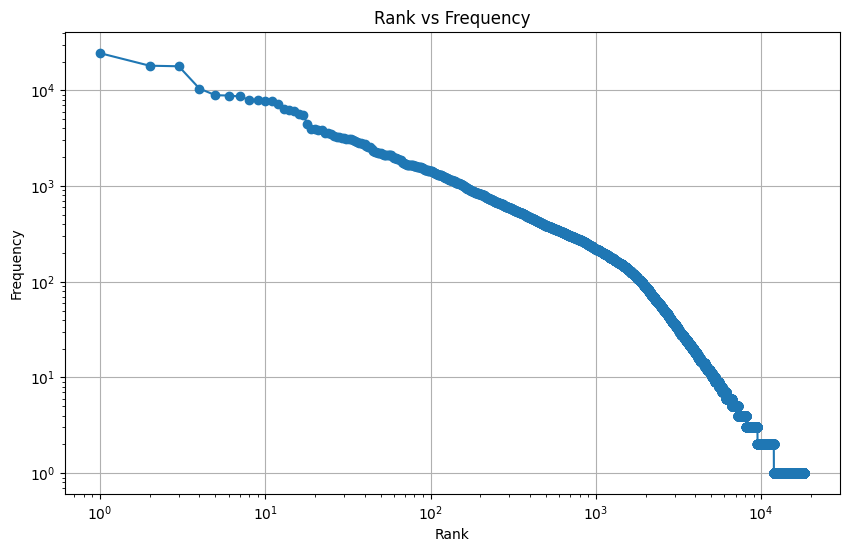

In [ ]:
Zipf_law = process_plot_zipflaw("orm")
Zipf_law

# Plotting Zipf Law for SWAHILI


Token indices sequence length is longer than the specified maximum sequence length for this model (518 > 512). Running this sequence through the model will result in indexing errors


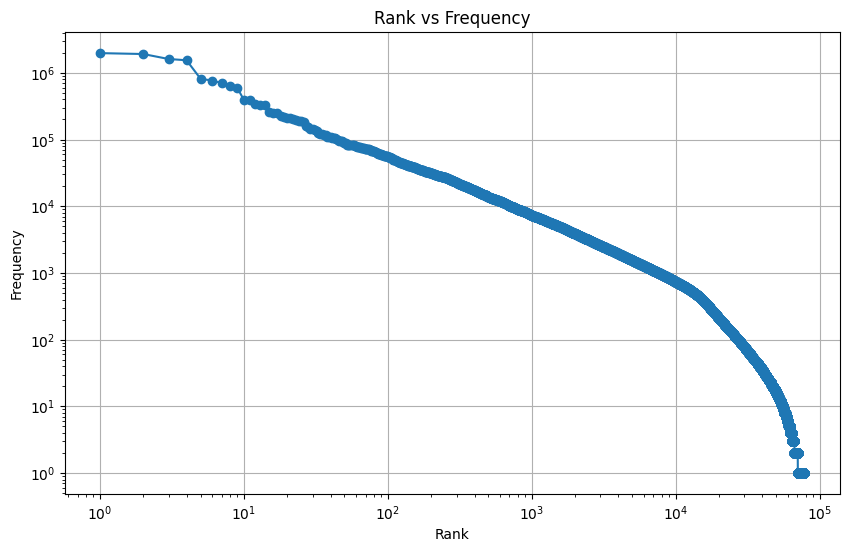

In [ ]:
Zipf_law = process_plot_zipflaw("swa")
Zipf_law

# Plotting Zipf Law for TIGRINYA

tir.txt:   0%|          | 0.00/29.7M [00:00<?, ?B/s]

tir.txt:   0%|          | 0.00/3.33M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/8240 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/915 [00:00<?, ? examples/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/convert_slow_tokenizer.py:551: UserWarning: The sentencepiece tokenizer that you are converting to a fast tokenizer uses the byte fallback option which is not implemented in the fast tokenizers. In practice this means that the fast version of the tokenizer can produce unknown tokens whereas the sentencepiece version would have converted these unknown tokens into a sequence of byte tokens matching the original piece of text.
  warnings.warn(
Token indices sequence length is longer than the specified maximum sequence length for this model (1827 > 512). 

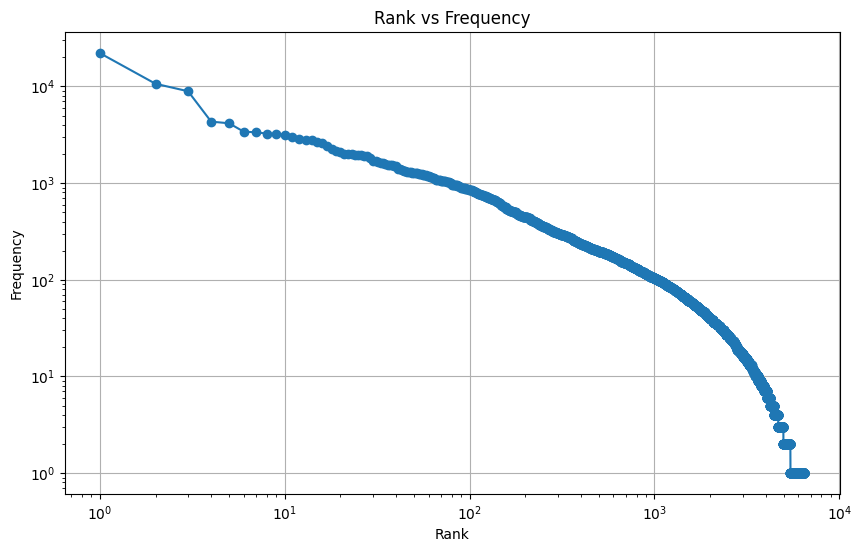

In [ ]:
Zipf_law = process_plot_zipflaw("tir")
Zipf_law

# Plotting Zipf Law for NYANJA

nya.txt:   0%|          | 0.00/254M [00:00<?, ?B/s]

nya.txt:   0%|          | 0.00/28.5M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/39647 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/4405 [00:00<?, ? examples/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/convert_slow_tokenizer.py:551: UserWarning: The sentencepiece tokenizer that you are converting to a fast tokenizer uses the byte fallback option which is not implemented in the fast tokenizers. In practice this means that the fast version of the tokenizer can produce unknown tokens whereas the sentencepiece version would have converted these unknown tokens into a sequence of byte tokens matching the original piece of text.
  warnings.warn(
Token indices sequence length is longer than the specified maximum sequence length for this model (807 > 512). R

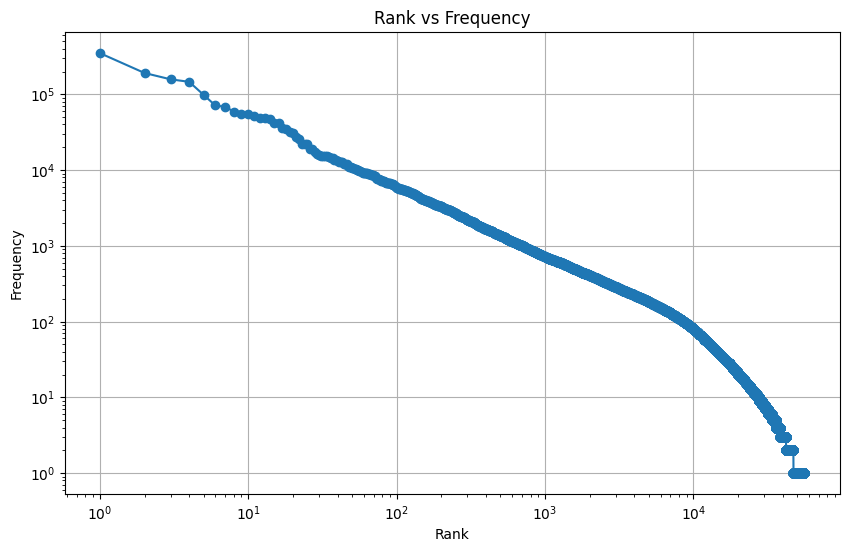

In [ ]:
Zipf_law = process_plot_zipflaw("nya")
Zipf_law

# Plotting Zipf Law for SHONA

sna.txt:   0%|          | 0.00/209M [00:00<?, ?B/s]

sna.txt:   0%|          | 0.00/23.8M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/60986 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/6776 [00:00<?, ? examples/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/convert_slow_tokenizer.py:551: UserWarning: The sentencepiece tokenizer that you are converting to a fast tokenizer uses the byte fallback option which is not implemented in the fast tokenizers. In practice this means that the fast version of the tokenizer can produce unknown tokens whereas the sentencepiece version would have converted these unknown tokens into a sequence of byte tokens matching the original piece of text.
  warnings.warn(
Token indices sequence length is longer than the specified maximum sequence length for this model (643 > 512). R

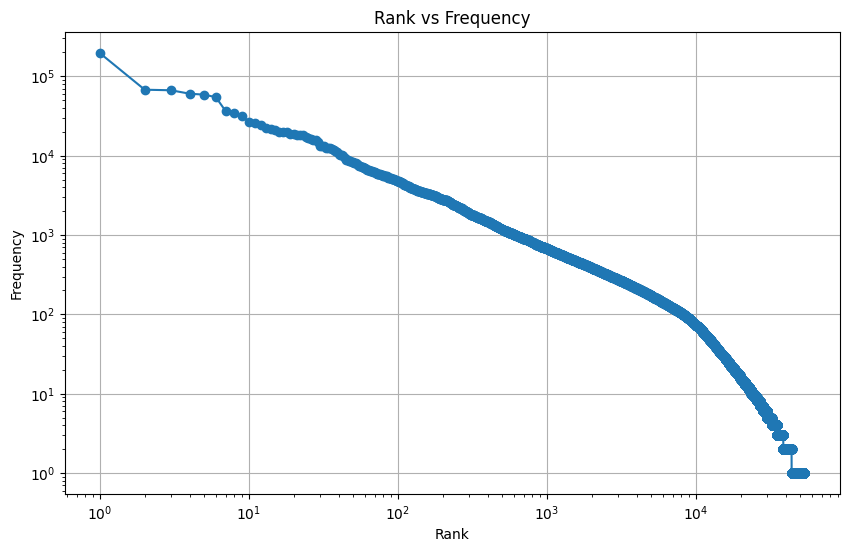

In [ ]:
Zipf_law = process_plot_zipflaw("sna")
Zipf_law

# Plotting Zipf Law for SOUTHERN SOTHO

sot.txt:   0%|          | 0.00/192M [00:00<?, ?B/s]

sot.txt:   0%|          | 0.00/21.5M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/38361 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/4262 [00:00<?, ? examples/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/convert_slow_tokenizer.py:551: UserWarning: The sentencepiece tokenizer that you are converting to a fast tokenizer uses the byte fallback option which is not implemented in the fast tokenizers. In practice this means that the fast version of the tokenizer can produce unknown tokens whereas the sentencepiece version would have converted these unknown tokens into a sequence of byte tokens matching the original piece of text.
  warnings.warn(
Token indices sequence length is longer than the specified maximum sequence length for this model (549 > 512). R

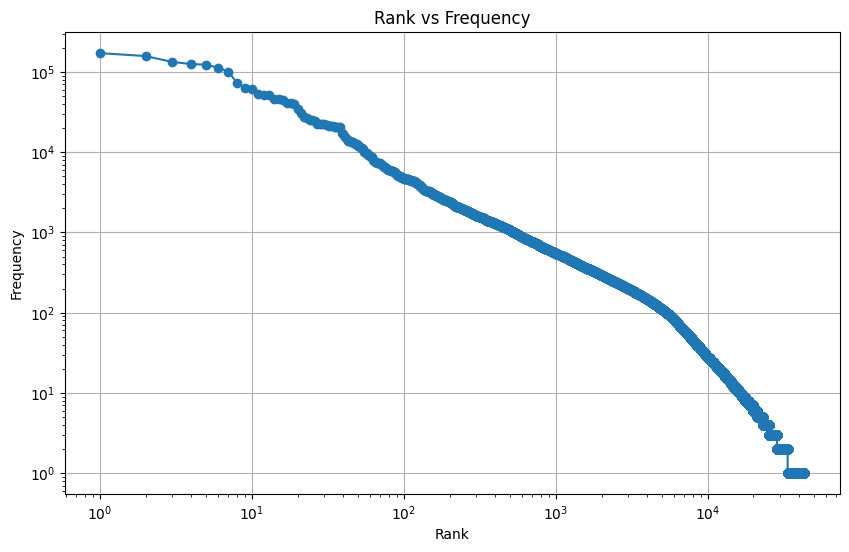

In [ ]:
Zipf_law = process_plot_zipflaw("sot")
Zipf_law

# In this project I plotted Zipf law for 10 African languages. Namely:
1. Yoruba
2. Igbo
3. Hausa
4. Zulu
5. Somali
6. Xhosa
7. Tigrinya
8. Amharic
9. Oromo
10. Nyanja

With the help of Zipf law we were able to figure out the tokens with the highest number of frequency and the lowest number of frequency. The plot shows how we ranked the tokens with the frequency and the token with the lower frequency.

Note: The tokens are ranked as per how they frequently occur in the dataset.


#ZULU

In [ ]:
data_zul = load_dataset("castorini/wura", "zul", level="passage", verification_mode="no_checks")

zul.txt:   0%|          | 0.00/263M [00:00<?, ?B/s]

zul.txt:   0%|          | 0.00/28.7M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/65447 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/7271 [00:00<?, ? examples/s]

In [ ]:
data_zul = pd.DataFrame(data_zul['train'])



In [ ]:
print(data_zul.head())

  id                                               text
0  0  Usayizi 31 MB Play 35 127 Zadalwa 14-10-2011 2...
1  1  VMO - Maximum Operating Speed 1,315 km / h MMO...
2  2  Qaphela ukuthi izenzo eziningi zingatholakala ...
3  3  Indaba Yokuphila: UJehova ‘Usiphathe Ngomusa’ ...
4  4  Lokhu kwangethusa kakhulu futhi kwenza ngangab...


In [ ]:
data_zul = data_zul.iloc[0:11000]['text']
print(data_zul)

0        Usayizi 31 MB Play 35 127 Zadalwa 14-10-2011 2...
1        VMO - Maximum Operating Speed 1,315 km / h MMO...
2        Qaphela ukuthi izenzo eziningi zingatholakala ...
3        Indaba Yokuphila: UJehova ‘Usiphathe Ngomusa’ ...
4        Lokhu kwangethusa kakhulu futhi kwenza ngangab...
                               ...                        
10995    Kort Termyn Motor Versekering Kwotasies Aanlyn...
10996    Umtjhado Sisipho Esivela KuZimu “Intambo enemi...
10997    5, 6. Umtjhado ungaba njani ‘yintambo enemitiy...
10998    9 Nasele usejimeni lokukhetha umlingani, ungat...
10999    Ngesikhathi u-Abrahamu akhethela u-Isaka umfaz...
Name: text, Length: 11000, dtype: object


In [ ]:
import string
import re


def remove_punctuations(text):
    text = re.sub(r'[^\w/\s]','', text)
    return text

data_zul = data_zul.apply(remove_punctuations)
print(data_zul)

0        Usayizi 31 MB Play 35 127 Zadalwa 14102011 20 ...
1        VMO  Maximum Operating Speed 1315 km / h MMO  ...
2        Qaphela ukuthi izenzo eziningi zingatholakala ...
3        Indaba Yokuphila UJehova Usiphathe Ngomusa  UJ...
4        Lokhu kwangethusa kakhulu futhi kwenza ngangab...
                               ...                        
10995    Kort Termyn Motor Versekering Kwotasies Aanlyn...
10996    Umtjhado Sisipho Esivela KuZimu Intambo enemit...
10997    5 6 Umtjhado ungaba njani yintambo enemitiya e...
10998    9 Nasele usejimeni lokukhetha umlingani ungath...
10999    Ngesikhathi uAbrahamu akhethela uIsaka umfazi ...
Name: text, Length: 11000, dtype: object


In [ ]:
tokenized_zul = []

for text in data_zul:
    tokens = tokenizer.tokenize(text)
    tokenized_zul.append(tokens)

print(tokenized_zul)

[['▁Usayizi', '▁', '3', '1', '▁MB', '▁Play', '▁', '3', '5', '▁', '1', '2', '7', '▁Za', 'dalwa', '▁', '1', '4', '1', '0', '2', '0', '1', '1', '▁', '2', '0', '▁', '3', '9', '▁', '1', '5', '▁Ku', 'shintshwe', '▁', '1', '9', '0', '6', '2', '0', '1', '2', '▁', '0', '2', '▁', '4', '1', '▁', '4', '9', '▁Umbhali', '▁', 'IRIS', '▁U', 'KUBA', 'LE', 'KELA', '▁se', 'kulingisa', '▁SO', 'FT', 'WARE', '▁FSX', '▁update', '▁Bob', '▁Chi', 'ci', 'lo', '▁http', '/', '/', 'www', 'iri', 'ssi', 'mulation', 's', 'com', 'au', '▁I', '▁Miko', 'yan', 'Gur', 'evich', '▁', 'MIG', '2', '9', '▁NATO', '▁ikhodi', '▁Ful', 'crum', '▁i', 'yinhlangano', '▁ndiza', '▁fighter', '▁kwe', 'Soviet', '▁emoyeni', '▁suprem', 'a', 'cy', '▁a', 'thuthu', 'kiswe', '▁', '1', '9', '7', '0', 's', '▁', 'okuqala', '▁futhi', '▁indiza', '▁yabo', '▁yokuqala', '▁zenzeka', '▁October', '▁', '6', '▁', '1', '9', '7', '7', '▁It', '▁wangena', '▁ebu', 'thweni', '▁le', 'zempi', '▁lase', 'Soviet', '▁', '1', '9', '8', '3', '▁futhi', '▁isa', 'setshenziswa'

In [ ]:
import string
import re


def remove_numerals(text):
    # Corrected: Removed the unnecessary re.findall and used re.sub to remove numerals
    text = re.sub(r'\d+', '', text)
    # Corrected: Now operates on the 'text' argument instead of the global 'tokenized_zul'
    tokens = [token for token in tokenizer.tokenize(text) if not re.search(r'\d', token)]
    return ' '.join(tokens)  # Join tokens back into a string

data_zul = data_zul.apply(remove_numerals)
print(data_zul)

0        ▁Usayizi ▁MB ▁Play ▁Za dalwa ▁Ku shintshwe ▁Um...
1        ▁V MO ▁Maximum ▁Operating ▁Speed ▁km ▁/ ▁h ▁M ...
2        ▁Qaphela ▁ukuthi ▁izenzo ▁eziningi ▁zi ngathol...
3        ▁Indaba ▁Yo kuphila ▁UJehova ▁Usi phathe ▁Ngo ...
4        ▁Lokhu ▁kwa nge thusa ▁kakhulu ▁futhi ▁kwenza ...
                               ...                        
10995    ▁Kort ▁Term yn ▁Motor ▁Versekering ▁Kwotasie s...
10996    ▁Um tjha do ▁Si sipho ▁Esi vela ▁Ku Zimu ▁I nt...
10997    ▁Um tjha do ▁ungaba ▁njani ▁yi ntambo ▁en emi ...
10998    ▁Na sele ▁use ji meni ▁l okukhetha ▁umlingani ...
10999    ▁Ngesikhathi ▁u Abraham u ▁akhe thela ▁u Isaka...
Name: text, Length: 11000, dtype: object


In [ ]:
from collections import Counter

all_tokens_zul = [token for sublist in tokenized_zul for token in sublist]

freq_zul = Counter(all_tokens_zul)

print(freq_zul)

Counter({'▁': 689569, '▁u': 46534, '▁e': 39457, '▁i': 39430, '▁a': 38550, '▁ku': 24449, '▁I': 23969, '▁futhi': 20703, '▁ukuthi': 20432, 's': 20068, '▁o': 20030, '▁U': 19218, '▁le': 18548, '▁ne': 17236, '▁ba': 15612, '▁ni': 15379, '▁si': 14033, '▁wa': 14018, '▁se': 13656, '▁yo': 13261, '▁no': 13172, '▁na': 13024, '▁la': 12949, '▁ka': 12932, '▁be': 12421, '▁we': 12367, '▁ye': 12321, '▁the': 12096, '▁kwe': 12008, '▁kanye': 10558, '▁nge': 10163, '▁noma': 9646, '▁lo': 9413, '▁ezi': 9401, '▁in': 9363, '▁ko': 9164, '▁uku': 8950, '▁A': 8617, '▁zi': 8394, '▁aba': 8364, '▁ya': 8313, '▁n': 8247, '▁kakhulu': 8194, '▁ama': 8070, '▁ngo': 7835, '▁ze': 7814, '▁ke': 7384, '▁yi': 7367, '▁kwa': 7222, '▁and': 7109, '▁/': 6992, '▁esi': 6712, '▁li': 6710, '▁za': 6423, '▁is': 6365, '▁ngi': 6087, '▁of': 5930, '▁so': 5748, '▁zo': 5731, '▁kodwa': 5586, '▁lapho': 5405, '▁sa': 5393, '▁ukuba': 5298, '▁abantu': 5265, '▁uma': 5215, '▁Ku': 5187, '▁oku': 5123, '▁to': 5095, '▁en': 5051, '▁ukuze': 5043, '▁nga': 4925, '▁

In [ ]:
sort_zul = sorted(freq_zul.items(), key=lambda x: x[1], reverse=True)

print(sort_zul)

[('▁', 689569), ('▁u', 46534), ('▁e', 39457), ('▁i', 39430), ('▁a', 38550), ('▁ku', 24449), ('▁I', 23969), ('▁futhi', 20703), ('▁ukuthi', 20432), ('s', 20068), ('▁o', 20030), ('▁U', 19218), ('▁le', 18548), ('▁ne', 17236), ('▁ba', 15612), ('▁ni', 15379), ('▁si', 14033), ('▁wa', 14018), ('▁se', 13656), ('▁yo', 13261), ('▁no', 13172), ('▁na', 13024), ('▁la', 12949), ('▁ka', 12932), ('▁be', 12421), ('▁we', 12367), ('▁ye', 12321), ('▁the', 12096), ('▁kwe', 12008), ('▁kanye', 10558), ('▁nge', 10163), ('▁noma', 9646), ('▁lo', 9413), ('▁ezi', 9401), ('▁in', 9363), ('▁ko', 9164), ('▁uku', 8950), ('▁A', 8617), ('▁zi', 8394), ('▁aba', 8364), ('▁ya', 8313), ('▁n', 8247), ('▁kakhulu', 8194), ('▁ama', 8070), ('▁ngo', 7835), ('▁ze', 7814), ('▁ke', 7384), ('▁yi', 7367), ('▁kwa', 7222), ('▁and', 7109), ('▁/', 6992), ('▁esi', 6712), ('▁li', 6710), ('▁za', 6423), ('▁is', 6365), ('▁ngi', 6087), ('▁of', 5930), ('▁so', 5748), ('▁zo', 5731), ('▁kodwa', 5586), ('▁lapho', 5405), ('▁sa', 5393), ('▁ukuba', 5298)

In [ ]:
ranks = range(1, len(freq_zul) +1)
frequencies = [freq for token, freq in sort_zul]

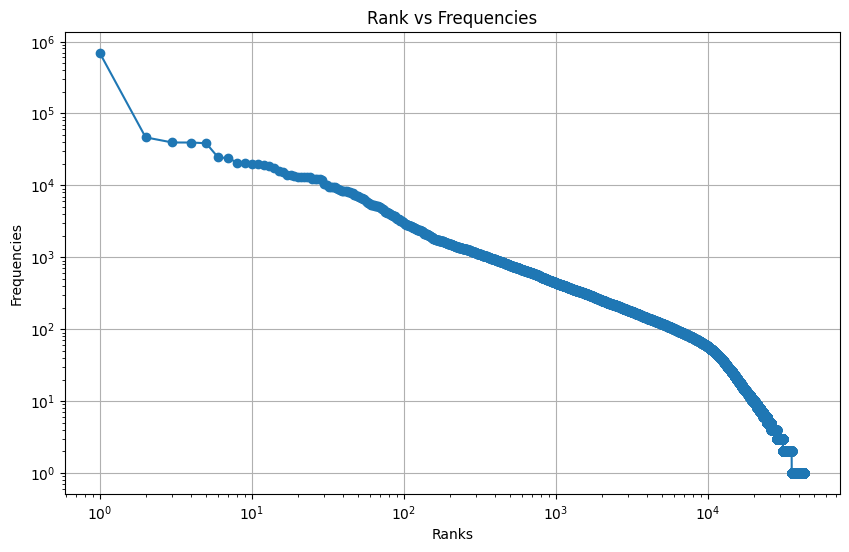

In [ ]:
# Plot

plt.figure(figsize=(10, 6))
plt.loglog(ranks, frequencies, marker='o')
plt.xlabel('Ranks')
plt.ylabel('Frequencies')
plt.title('Rank vs Frequencies')
plt.grid(True)
plt.show()

#AMHARIC

In [ ]:
data_amh = load_dataset("castorini/wura", "amh", level="passage", verification_mode="no_checks")

README.md:   0%|          | 0.00/11.1k [00:00<?, ?B/s]

wura.py:   0%|          | 0.00/3.80k [00:00<?, ?B/s]

The repository for castorini/wura contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/castorini/wura.
You can avoid this prompt in future by passing the argument `trust_remote_code=True`.

Do you wish to run the custom code? [y/N] y


amh.txt:   0%|          | 0.00/1.06G [00:00<?, ?B/s]

In [ ]:
data_amh = pd.DataFrame(data_amh['train'])

print(data_amh.head())



  id                                               text
0  0  ህጻን ልጃቸውን ለ7 ዓመታት የቆለፉባት ጀርመናውያን ቤተሰቦች ምርመራ ተከ...
1  1  ታይላንድ፡ በትምህርት ቤቷ ከደረሰው ጥቃት የተረፈችው ብቸኛዋ የሦስት ዓመ...
2  2  በግብፅ የኦርቶዶክስ ቤተክርስቲያን የእሳት አደጋ ሦስት መንትዮችን ጨምሮ ...
3  3  “የልጃችንን ገዳይ ሳናውቅ አናርፍም” ወቅቱ እንደ አውሮፓውያኑ 1984 ነ...
4  4  ስትልም ትጠይቃለች። በጥልቅ ሐዘናቸው ላይ የፖሊስ ምርመራ እንዲሁም የሚዲ...


In [ ]:
data_amh = data_amh.iloc[0:10000]['text']
print(data_amh)

0       ህጻን ልጃቸውን ለ7 ዓመታት የቆለፉባት ጀርመናውያን ቤተሰቦች ምርመራ ተከ...
1       ታይላንድ፡ በትምህርት ቤቷ ከደረሰው ጥቃት የተረፈችው ብቸኛዋ የሦስት ዓመ...
2       በግብፅ የኦርቶዶክስ ቤተክርስቲያን የእሳት አደጋ ሦስት መንትዮችን ጨምሮ ...
3       “የልጃችንን ገዳይ ሳናውቅ አናርፍም” ወቅቱ እንደ አውሮፓውያኑ 1984 ነ...
4       ስትልም ትጠይቃለች። በጥልቅ ሐዘናቸው ላይ የፖሊስ ምርመራ እንዲሁም የሚዲ...
                              ...                        
9995    የህወሓት ቃለ አቀባይ ጌታቸው እንደሚናገሩት የትግራይ ክልል ከጦርነቱ በፊ...
9996    ትግራይ፡ ተመድ የትግራይ ኃይል በአስቸኳይ የተኩስ አቁም እንዲያደርግ አሳ...
9997    አቶ ጌታቸው ረዳ ወደ አማራ ልንዘምት እንችላለን ሲሉ የክልሉ ብልጽግና ጽ...
9998    መዋሸት አያስፈልግም አሁንም እናስባለን። ስጋትም አለን። ፈጣሪ ደግሞ አለ...
9999                                 የተከዜን ድልድይ ማን አፈረሰው?
Name: text, Length: 10000, dtype: object


In [ ]:
import string
import re

def remove_punctuations(text):
    text = re.sub(r'[^\w/\s]','', text)
    return text

data_amh = data_amh.apply(remove_punctuations)


In [ ]:
tokenized_amh = []

for text in data_amh:
  tokens = tokenizer.tokenize(text)
  tokenized_amh.append(tokens)

print(tokenized_amh)


In [ ]:
import string
import re

from collections import Counter

all_tokens_amh = [token for sublist in tokenized_amh for token in sublist]

freq_amh = Counter(all_tokens_amh)

print(freq_amh)

Counter({'▁': 179254, 'ን': 68919, '▁በ': 64003, '▁የ': 62095, 'ም': 49226, '▁ከ': 43590, '▁ነው': 40469, '▁ላይ': 35065, 'ና': 32467, '0': 28162, '▁እና': 27475, 'ው': 26613, '▁ለ': 25369, '1': 24936, '2': 20433, '▁ውስጥ': 19855, 'ት': 18703, '▁ወደ': 18090, '▁ነበር': 17736, 'ል': 14375, '▁ጋር': 13253, '▁አ': 12782, '▁ግን': 12304, '▁ሰዎች': 11579, '▁እንደ': 11203, '▁ሲ': 10833, '▁መ': 10699, '▁ሲሆን': 10603, 'ር': 10325, '▁የሚ': 10145, '▁ይ': 9292, '▁በኋላ': 9228, '▁ጊዜ': 8986, '5': 8970, '▁እንዲ': 8932, 'በት': 8801, '▁ይህ': 8794, '▁ቤት': 8779, 'ች': 8742, '3': 8652, '▁ነገር': 8645, '9': 8613, 'ስ': 8594, '▁ደግሞ': 8538, '4': 7995, 'ቱ': 7781, 'ዎች': 7746, '▁መንግሥት': 7609, '▁ተ': 7487, '▁እ': 7299, '▁ብለዋል': 6848, 'ዋ': 6778, '▁ዓመት': 6747, 'ሉ': 6694, 'ውን': 6684, '▁ሊ': 6544, '▁ያ': 6528, '▁አንድ': 6406, 'ድ': 6124, 'ዋል': 6001, '▁ከፍተኛ': 5892, '▁ናቸው': 5790, '▁እንደሚ': 5688, '7': 5682, '▁ማ': 5637, '▁የተ': 5617, '/': 5593, '8': 5455, '▁በፊት': 5440, '▁መካከል': 5428, '▁እየ': 5406, '▁አገራት': 5398, '▁ሁኔታ': 5366, '▁ምክንያት': 5272, '6': 5228, '▁በላይ': 5186, '▁አል': 5

In [ ]:
sort_amh = sorted(freq_amh.items(), key=lambda x: x[1], reverse=True)

print(sort_amh)

[('▁', 179254), ('ን', 68919), ('▁በ', 64003), ('▁የ', 62095), ('ም', 49226), ('▁ከ', 43590), ('▁ነው', 40469), ('▁ላይ', 35065), ('ና', 32467), ('0', 28162), ('▁እና', 27475), ('ው', 26613), ('▁ለ', 25369), ('1', 24936), ('2', 20433), ('▁ውስጥ', 19855), ('ት', 18703), ('▁ወደ', 18090), ('▁ነበር', 17736), ('ል', 14375), ('▁ጋር', 13253), ('▁አ', 12782), ('▁ግን', 12304), ('▁ሰዎች', 11579), ('▁እንደ', 11203), ('▁ሲ', 10833), ('▁መ', 10699), ('▁ሲሆን', 10603), ('ር', 10325), ('▁የሚ', 10145), ('▁ይ', 9292), ('▁በኋላ', 9228), ('▁ጊዜ', 8986), ('5', 8970), ('▁እንዲ', 8932), ('በት', 8801), ('▁ይህ', 8794), ('▁ቤት', 8779), ('ች', 8742), ('3', 8652), ('▁ነገር', 8645), ('9', 8613), ('ስ', 8594), ('▁ደግሞ', 8538), ('4', 7995), ('ቱ', 7781), ('ዎች', 7746), ('▁መንግሥት', 7609), ('▁ተ', 7487), ('▁እ', 7299), ('▁ብለዋል', 6848), ('ዋ', 6778), ('▁ዓመት', 6747), ('ሉ', 6694), ('ውን', 6684), ('▁ሊ', 6544), ('▁ያ', 6528), ('▁አንድ', 6406), ('ድ', 6124), ('ዋል', 6001), ('▁ከፍተኛ', 5892), ('▁ናቸው', 5790), ('▁እንደሚ', 5688), ('7', 5682), ('▁ማ', 5637), ('▁የተ', 5617), ('/', 5593), ('8',

In [ ]:
Ranks = range(1, len(freq_amh) +1)
Frequencies = [freq for token, freq in sort_amh]

print(Ranks)
print(Frequencies)

range(1, 14550)
[179254, 68919, 64003, 62095, 49226, 43590, 40469, 35065, 32467, 28162, 27475, 26613, 25369, 24936, 20433, 19855, 18703, 18090, 17736, 14375, 13253, 12782, 12304, 11579, 11203, 10833, 10699, 10603, 10325, 10145, 9292, 9228, 8986, 8970, 8932, 8801, 8794, 8779, 8742, 8652, 8645, 8613, 8594, 8538, 7995, 7781, 7746, 7609, 7487, 7299, 6848, 6778, 6747, 6694, 6684, 6544, 6528, 6406, 6124, 6001, 5892, 5790, 5688, 5682, 5637, 5617, 5593, 5455, 5440, 5428, 5406, 5398, 5366, 5272, 5228, 5186, 5055, 5026, 5002, 4986, 4984, 4896, 4877, 4834, 4823, 4759, 4728, 4705, 4667, 4642, 4592, 4586, 4443, 4436, 4401, 4375, 4369, 4357, 4347, 4290, 4271, 4169, 4160, 4143, 4091, 4090, 4080, 4072, 4047, 4046, 4033, 3949, 3948, 3941, 3937, 3929, 3869, 3842, 3840, 3798, 3784, 3757, 3749, 3717, 3698, 3686, 3674, 3673, 3645, 3629, 3610, 3604, 3581, 3565, 3553, 3548, 3548, 3535, 3530, 3515, 3511, 3507, 3506, 3473, 3466, 3434, 3431, 3422, 3400, 3367, 3356, 3343, 3341, 3330, 3316, 3299, 3289, 3287, 3265

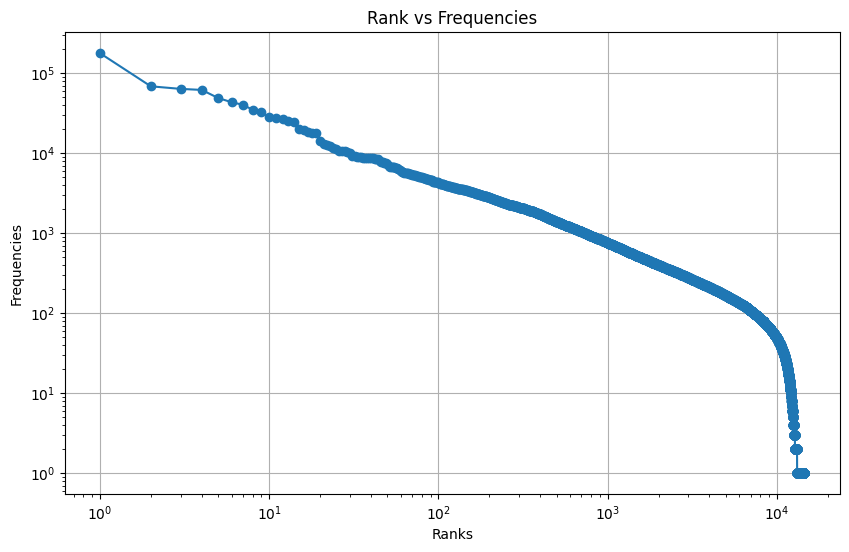

In [ ]:
#Plot

plt.figure(figsize=(10, 6))
plt.loglog(Ranks, Frequencies, marker='o')
plt.xlabel('Ranks')
plt.ylabel('Frequencies')
plt.title('Rank vs Frequencies')
plt.grid(True)